In [2]:
import os
import tarfile
from urllib.request import urlretrieve

# Define the URL and the download location
url = "http://vis-www.cs.umass.edu/lfw/lfw.tgz"
download_location = "lfw.tgz"

# Download the dataset
urlretrieve(url, download_location)

# Extract the dataset
with tarfile.open(download_location, "r:gz") as tar:
    tar.extractall()

# Remove the tar file
os.remove(download_location)



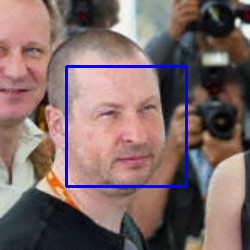

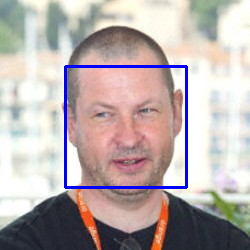

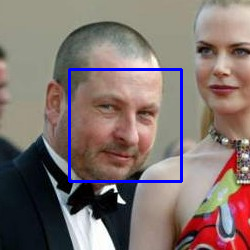

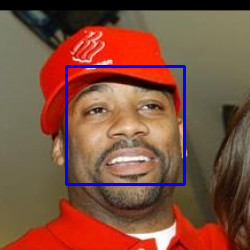

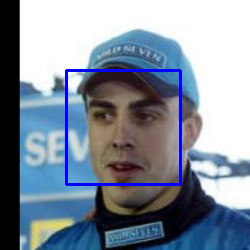

...

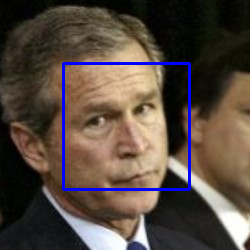

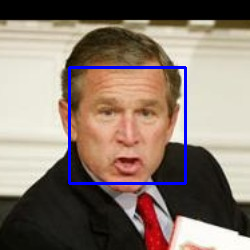

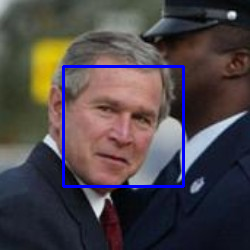

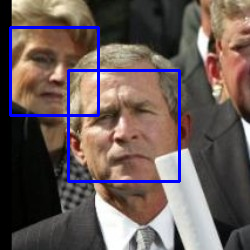

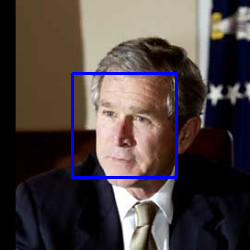

In [ ]:
import cv2
import os
from google.colab.patches import cv2_imshow # Import the Colab patch

# Load the pre-trained Haar Cascade classifier for face detection
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Define the path to the LFW dataset
lfw_path = "lfw"

# Iterate through a few images in the dataset
for person_name in os.listdir(lfw_path):
    person_folder = os.path.join(lfw_path, person_name)
    if os.path.isdir(person_folder):
        for image_name in os.listdir(person_folder):
            image_path = os.path.join(person_folder, image_name)

            # Read the image
            image = cv2.imread(image_path)
            if image is None:
                continue
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

            # Detect faces in the image
            faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5, minSize=(30, 30))

            # Draw rectangles around the detected faces
            for (x, y, w, h) in faces:
                cv2.rectangle(image, (x, y), (x + w, y + h), (255, 0, 0), 2)

            # Display the output using the Colab patch
            cv2_imshow(image) # Use cv2_imshow instead of cv2.imshow
            if cv2.waitKey(0) & 0xFF == ord('q'):
                break

cv2.destroyAllWindows()